<a href="https://colab.research.google.com/github/SwapnasumaM/Breast-cancer-Detection/blob/main/DATA240_Assignment2_Name_SJSU_ID_piynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**importing the libraries**

In [1]:
import pandas as pd 
import numpy as np  
import matplotlib.pyplot as plt  
import seaborn as sns  

# **DATA CLEANING**

In [2]:
df=pd.read_csv("/content/data2.csv")
type(df)
df.keys()

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [3]:
df.dtypes

diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst            float64
concave points_worst

In [4]:
df['diagnosis']

0      M
1      M
2      M
3      M
4      M
      ..
564    M
565    M
566    M
567    M
568    B
Name: diagnosis, Length: 569, dtype: object

In [5]:
df['diagnosis'] = df['diagnosis'].map({'M': 0, 'B': 1})
df['diagnosis'].head(5)

0    0
1    0
2    0
3    0
4    0
Name: diagnosis, dtype: int64

In [6]:
df.isnull().sum()

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [7]:
df.describe()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.627417,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,1.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    int64  
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

# **DATA VISUALIZATION**

In [ ]:
sns.pairplot(df, hue ='diagnosis')

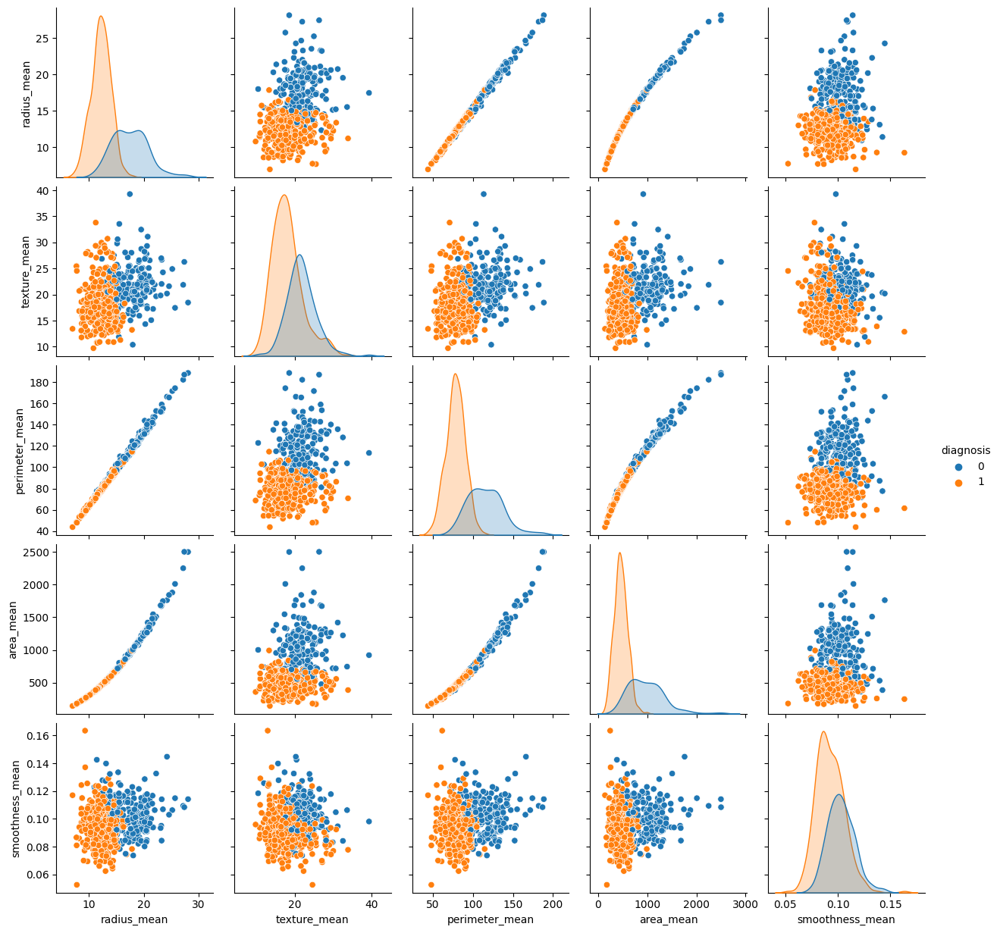

In [ ]:
sns.pairplot(df, hue = 'diagnosis', 
            vars = ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean'] )

<Axes: xlabel='diagnosis', ylabel='count'>

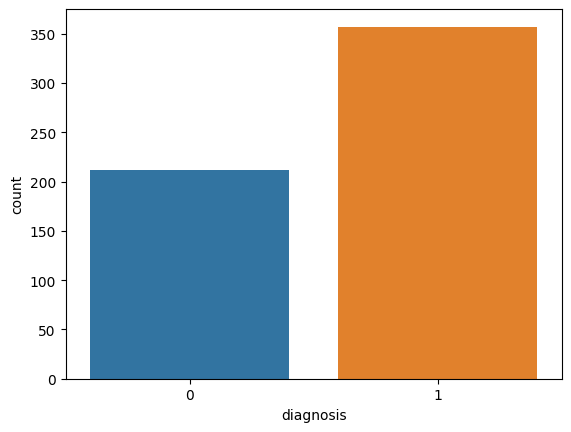

In [ ]:
sns.countplot(x='diagnosis', data=df)

<Axes: xlabel='radius_mean', ylabel='count'>

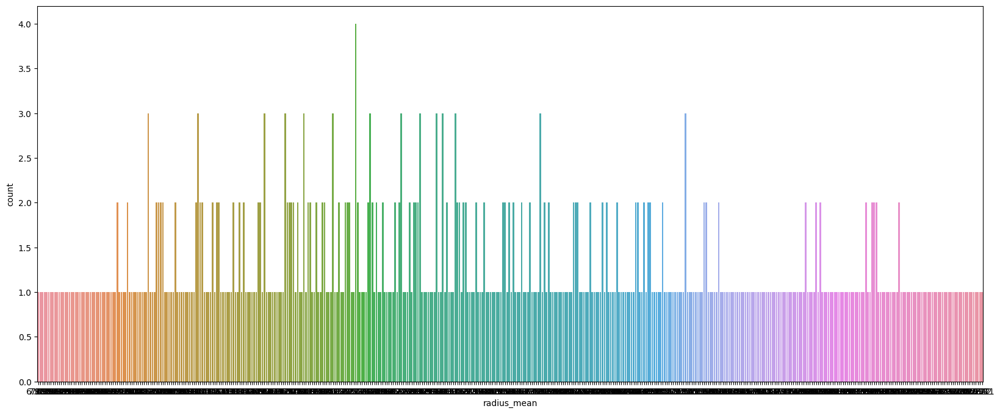

In [ ]:
plt.figure(figsize = (20,8))
sns.countplot(x='radius_mean',data=df)

<Axes: >

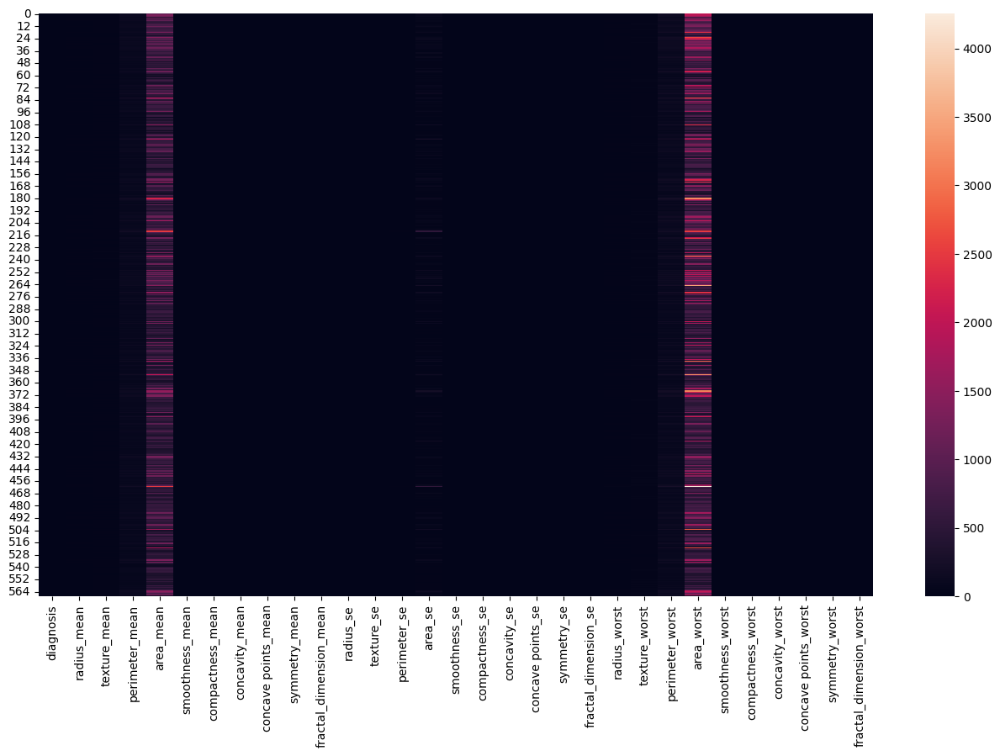

In [ ]:
plt.figure(figsize=(16,9))
sns.heatmap(df)

<Axes: >

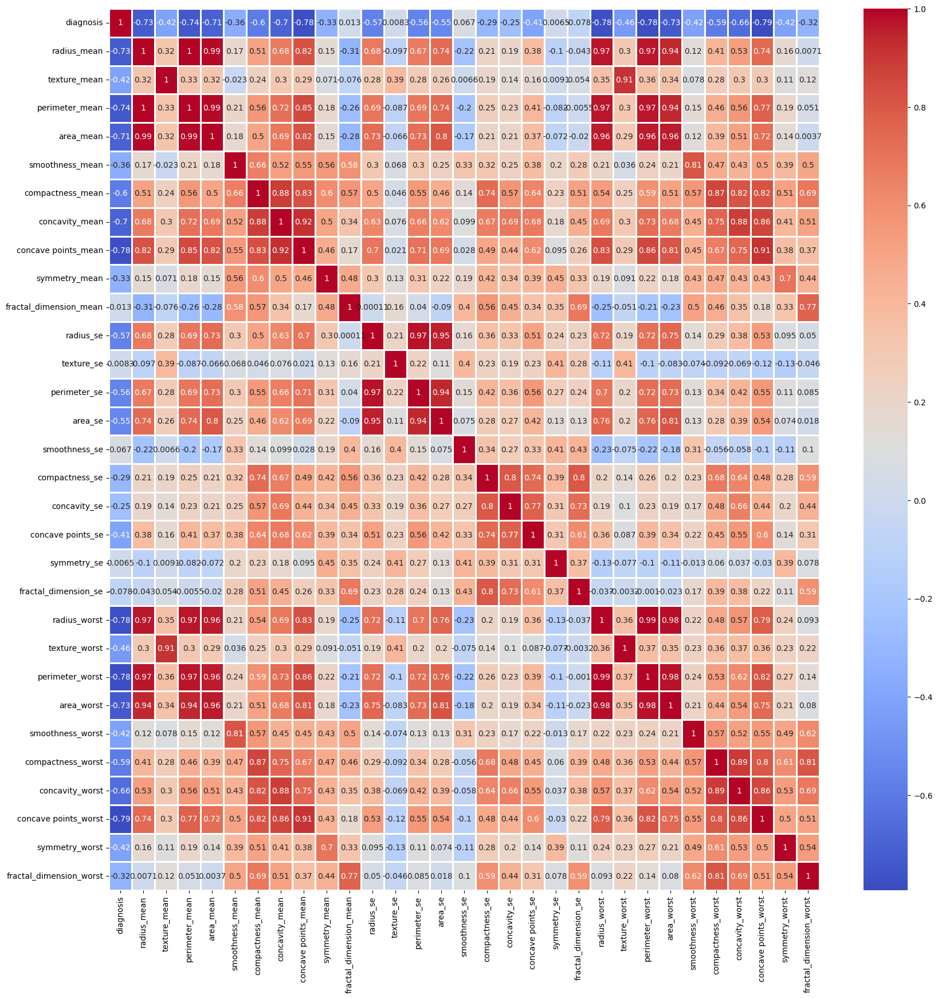

In [ ]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(), annot = True, cmap ='coolwarm', linewidths=2)

In [ ]:
df2 = df.drop(['diagnosis'], axis = 1)

# **DATA PREPROCESSING**

In [9]:
X = df.drop(['diagnosis'], axis = 1)
X.head(6)

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678
5,12.45,15.70,82.57,477.1,0.12780,0.17000,0.1578,0.08089,0.2087,0.07613,...,15.47,23.75,103.40,741.6,0.1791,0.5249,0.5355,0.1741,0.3985,0.12440


In [10]:
y = df['diagnosis']
y.head(6)

0    0
1    0
2    0
3    0
4    0
5    0
Name: diagnosis, dtype: int64

In [11]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state= 5)

In [12]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.transform(X_test)

Applying ML Algorithms

1.Decision Tree classifier
a) Entropy (C1) and GINI (C2) and compare the performance

In [23]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.tree import DecisionTreeClassifier

# Create a Decision Tree Classifier using Gini criterion
dt_gini = DecisionTreeClassifier(criterion='gini', random_state=51)

# Fit the model on training data
dt_gini.fit(X_train, y_train)

# Predict on test data
y_pred_gini = dt_gini.predict(X_test)

# Print accuracy score
print('Accuracy score using Gini criterion:', accuracy_score(y_test, y_pred_gini))

# Create a Decision Tree Classifier using Entropy criterion
dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=51)

# Fit the model on training data
dt_entropy.fit(X_train, y_train)

# Predict on test data
y_pred_entropy = dt_entropy.predict(X_test)

# Print accuracy score
print('Accuracy score using Entropy criterion:', accuracy_score(y_test, y_pred_entropy))


Accuracy score using Gini criterion: 0.935672514619883
Accuracy score using Entropy criterion: 0.935672514619883


b)Visualize the C1 and C2 by using the “graphviz” library 

In [24]:
!pip install graphviz


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


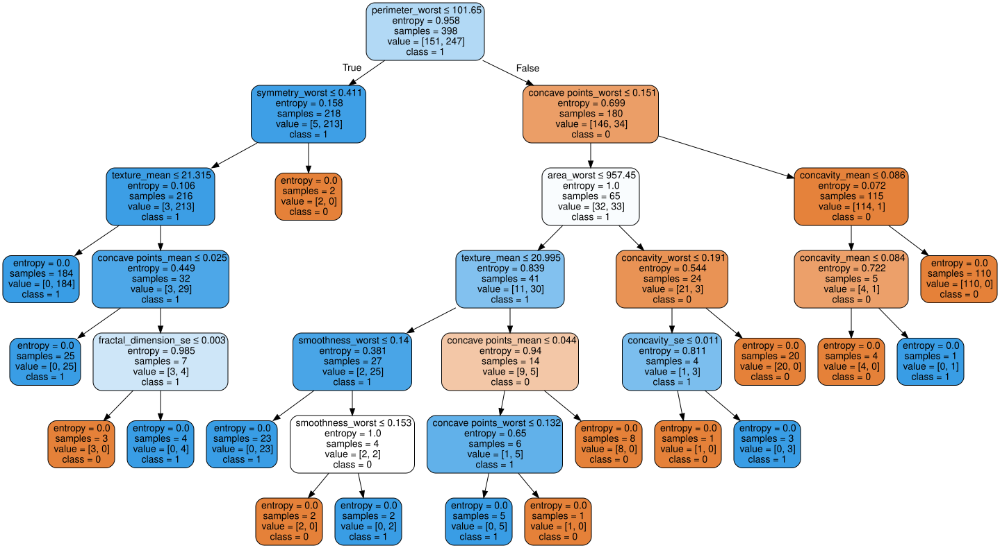

In [25]:
from sklearn.tree import export_graphviz
import graphviz

# Visualize the Decision Tree with Gini criterion
dot_data_gini = export_graphviz(dt_gini, out_file=None, 
                      feature_names=X_train.columns,  
                      class_names=['0', '1'],  
                      filled=True, rounded=True,  
                      special_characters=True)
graph_gini = graphviz.Source(dot_data_gini)  
graph_gini.render('decision_tree_gini', format='png')
graph_gini

# Visualize the Decision Tree with Entropy criterion
dot_data_entropy = export_graphviz(dt_entropy, out_file=None, 
                      feature_names=X_train.columns,  
                      class_names=['0', '1'],  
                      filled=True, rounded=True,  
                      special_characters=True)
graph_entropy = graphviz.Source(dot_data_entropy)  
graph_entropy.render('decision_tree_entropy', format='png')
graph_entropy


c)Prune C1 and C2 by limiting the depth and compare their performance with the unpruned versions.

In [26]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Create a Decision Tree Classifier using Gini criterion
dt_gini = DecisionTreeClassifier(criterion='gini', random_state=51, max_depth=3)

# Fit the model on training data
dt_gini.fit(X_train, y_train)

# Predict on test data
y_pred_gini_pruned = dt_gini.predict(X_test)

# Print accuracy score
print('Accuracy score using pruned Decision Tree with Gini criterion:', accuracy_score(y_test, y_pred_gini_pruned))

# Create a Decision Tree Classifier using Entropy criterion
dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=51, max_depth=3)

# Fit the model on training data
dt_entropy.fit(X_train, y_train)

# Predict on test data
y_pred_entropy_pruned = dt_entropy.predict(X_test)

# Print accuracy score
print('Accuracy score using pruned Decision Tree with Entropy criterion:', accuracy_score(y_test, y_pred_entropy_pruned))


Accuracy score using pruned Decision Tree with Gini criterion: 0.9532163742690059
Accuracy score using pruned Decision Tree with Entropy criterion: 0.9590643274853801


d) Use depth 1,…,20 and plot the performance for C1 and C2 separately. 

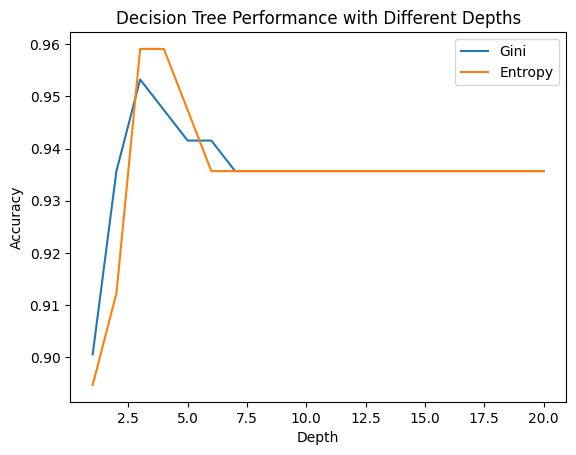

In [27]:
import matplotlib.pyplot as plt
import numpy as np

# Create empty lists to store accuracy scores for Gini and Entropy
accuracy_scores_gini = []
accuracy_scores_entropy = []

# Create Decision Trees with different depths, fit on training data, and evaluate on test data
for depth in range(1, 21):
    dt_gini = DecisionTreeClassifier(criterion='gini', random_state=51, max_depth=depth)
    dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=51, max_depth=depth)
    
    dt_gini.fit(X_train, y_train)
    y_pred_gini = dt_gini.predict(X_test)
    accuracy_gini = accuracy_score(y_test, y_pred_gini)
    accuracy_scores_gini.append(accuracy_gini)
    
    dt_entropy.fit(X_train, y_train)
    y_pred_entropy = dt_entropy.predict(X_test)
    accuracy_entropy = accuracy_score(y_test, y_pred_entropy)
    accuracy_scores_entropy.append(accuracy_entropy)

# Plot the accuracy scores for Gini and Entropy criterion
depths = np.arange(1, 21)
plt.plot(depths, accuracy_scores_gini, label='Gini')
plt.plot(depths, accuracy_scores_entropy, label='Entropy')
plt.xlabel('Depth')
plt.ylabel('Accuracy')
plt.title('Decision Tree Performance with Different Depths')
plt.legend()
plt.show()


2.Random Forest Classifier
a)Train an RF classifier with 10 estimators and compare the performance for the test set with C1.

In [32]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 51)
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
accuracy_score(y_test, y_pred_rf)

0.9707602339181286

b)Change the number of estimators from 10,50,100,500, 1000, and plot the performance.

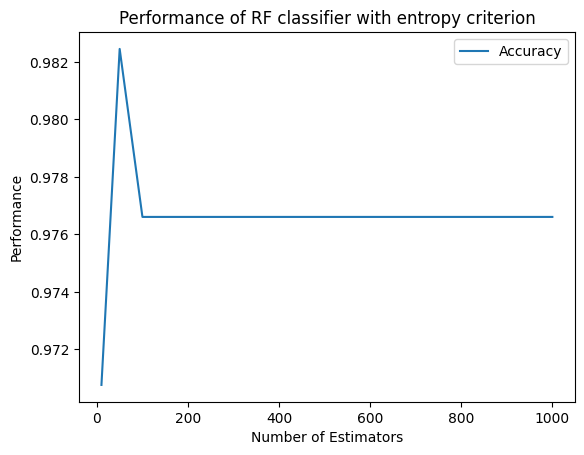

In [34]:
import matplotlib.pyplot as plt

# Define a list of number of estimators
n_estimators = [10, 50, 100, 500, 1000]

# Initialize empty lists to store evaluation metrics
acc_scores = []


# Loop over number of estimators
for n in n_estimators:
    # Train RF classifier with n estimators and entropy criterion
    rf_classifier = RandomForestClassifier(n_estimators=n, criterion='entropy', random_state=51)
    rf_classifier.fit(X_train, y_train)
    
    # Predict test labels
    y_pred_rf = rf_classifier.predict(X_test)
    
    # Calculate evaluation metrics
    acc = accuracy_score(y_test, y_pred_rf)
    
    
    # Append scores to lists
    acc_scores.append(acc)
    

# Plot performance for each number of estimators
plt.plot(n_estimators, acc_scores, label='Accuracy')
plt.xlabel('Number of Estimators')
plt.ylabel('Performance')
plt.title('Performance of RF classifier with entropy criterion')
plt.legend()
plt.show()


c) Perform 5 fold cross-validation and report the performance for RF classifier with 50 estimators 

In [35]:
from sklearn.model_selection import cross_val_score
from sklearn.datasets import make_classification
X, y = make_classification(n_samples=1000, n_features=10, n_informative=5, n_classes=2, random_state=42)

# Create a Random Forest classifier with 50 estimators
rf = RandomForestClassifier(n_estimators=50, random_state=42)

# Perform 5-fold cross-validation and calculate the accuracy score
scores = cross_val_score(rf, X, y, cv=5)
mean_accuracy = np.mean(scores)

# Print the results
print("Accuracy scores for each fold:", scores)
print("Mean accuracy score:", mean_accuracy)

Accuracy scores for each fold: [0.925 0.935 0.94  0.94  0.94 ]
Mean accuracy score: 0.9359999999999999


d)Plot the feature importance for RF with 200 estimators using the mean decrease in impurity and also feature permutation and explain the plots. 

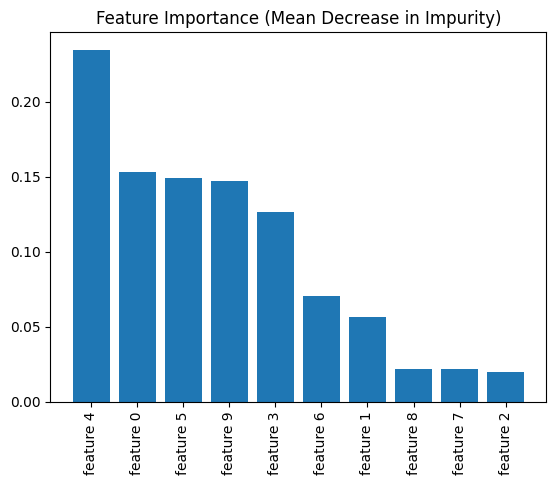

In [39]:
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import numpy as np

# Load your data and split it into features and target variables
# X = ...
# y = ...

# Create a Random Forest classifier with 200 estimators
rf = RandomForestClassifier(n_estimators=200, random_state=42)

# Fit the classifier to the data
rf.fit(X, y)

# Get the feature importances from the Random Forest classifier
importances = rf.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Rearrange feature names so they match the sorted feature importances
names = [f"feature {i}" for i in indices]

# Create plot
plt.figure()

# Create plot title
plt.title("Feature Importance (Mean Decrease in Impurity)")

# Add bars
plt.bar(range(X.shape[1]), importances[indices])

# Add feature names as x-axis labels
plt.xticks(range(X.shape[1]), names, rotation=90)

# Show plot
plt.show()


Ada Boost Classifier
a)Train a classifier with 10 estimators and compare the performance with C1 and RF in 2a.

In [40]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier

# Create an AdaBoost classifier with a decision tree base estimator and 10 estimators
adb_classifier = AdaBoostClassifier(
                    DecisionTreeClassifier(criterion='entropy', random_state=200),
                    n_estimators=10,
                    learning_rate=0.1,
                    algorithm='SAMME.R',
                    random_state=1
                )

# Fit the AdaBoost classifier to the training data
adb_classifier.fit(X_train, y_train)

# Use the trained model to predict on the test data
y_pred_adb = adb_classifier.predict(X_test)

# Evaluate the performance of the model
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred_adb)
print(f"Accuracy: {accuracy}")


Accuracy: 0.9590643274853801


b)Change the number of estimators from 10,50,100,500, 1000, and plot the performance. 

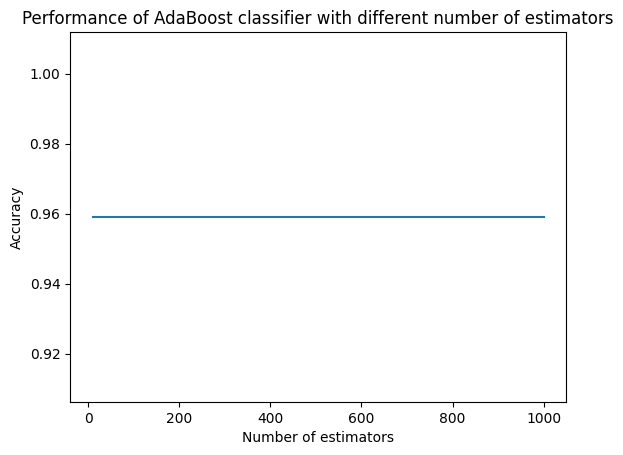

In [41]:
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score

estimators = [10, 50, 100, 500, 1000]
accuracies = []

for n_estimators in estimators:
    # Create an AdaBoost classifier with a decision tree base estimator and specified number of estimators
    adb_classifier = AdaBoostClassifier(
                        DecisionTreeClassifier(criterion='entropy', random_state=200),
                        n_estimators=n_estimators,
                        learning_rate=0.1,
                        algorithm='SAMME.R',
                        random_state=1
                    )

    # Fit the AdaBoost classifier to the training data
    adb_classifier.fit(X_train, y_train)

    # Use the trained model to predict on the test data
    y_pred_adb = adb_classifier.predict(X_test)

    # Evaluate the performance of the model
    accuracy = accuracy_score(y_test, y_pred_adb)
    accuracies.append(accuracy)

# Plot the performance of the AdaBoost classifier with different number of estimators
plt.plot(estimators, accuracies)
plt.title('Performance of AdaBoost classifier with different number of estimators')
plt.xlabel('Number of estimators')
plt.ylabel('Accuracy')
plt.show()


c) Perform 5 fold cross-validation and report the performance for classifier with 50 estimators 

In [42]:
from sklearn.model_selection import cross_val_score

# Create an AdaBoost classifier with a decision tree base estimator and 50 estimators
adb_classifier = AdaBoostClassifier(
                    DecisionTreeClassifier(criterion='entropy', random_state=200),
                    n_estimators=50,
                    learning_rate=0.1,
                    algorithm='SAMME.R',
                    random_state=1
                )

# Perform 5-fold cross-validation on the classifier
scores = cross_val_score(adb_classifier, X, y, cv=5)

# Report the performance of the classifier
print('Accuracy scores for 5-fold cross-validation: {}'.format(scores))
print('Mean accuracy: {:.2f}'.format(scores.mean()))
print('Standard deviation: {:.2f}'.format(scores.std()))


Accuracy scores for 5-fold cross-validation: [0.905 0.885 0.94  0.885 0.91 ]
Mean accuracy: 0.91
Standard deviation: 0.02


Naive_Bayes
Train a classifier and compare the performance for the test set with C1 and 2a and 3a. 

In [43]:
from sklearn.naive_bayes import GaussianNB
nb_classifier = GaussianNB()
nb_classifier.fit(X_train, y_train)

# Evaluate the performance of the Naive Bayes classifier on the test set
y_pred_nb = nb_classifier.predict(X_test)
nb_accuracy = accuracy_score(y_test, y_pred_nb)
print('Accuracy of Naive Bayes: {:.2f}'.format(nb_accuracy))

Accuracy of Naive Bayes: 0.95


In [44]:
from sklearn.decomposition import PCA

# Perform PCA on the data
pca = PCA()
X_pca = pca.fit_transform(X)

# Calculate the cumulative proportion of variance explained by each component
cumulative_var = np.cumsum(pca.explained_variance_ratio_)

# Find the index of the first component that explains at least 95% of the total variation
n_components = np.argmax(cumulative_var >= 0.95) + 1

# Print the cumulative proportion of variance explained by each component
print('Cumulative Proportion of Variance Explained by Components:')
print(cumulative_var)

# Print the number of components needed to explain 95% of the total variation
print('\nNumber of Components Needed to Explain 95% of Total Variation: {}'.format(n_components))

# Keep only the features that account for more than 95% of the total variation
X_pca_95 = X_pca[:, :n_components]


Cumulative Proportion of Variance Explained by Components:
[0.47656511 0.65526389 0.75742979 0.83744147 0.88449312 0.92478384
 0.96270338 1.         1.         1.        ]

Number of Components Needed to Explain 95% of Total Variation: 7


In [46]:
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Perform PCA to reduce features
pca = PCA(n_components=None)
X_pca = pca.fit_transform(X_train)
cumulative_var_ratio = np.cumsum(pca.explained_variance_ratio_)
n_components = np.argmax(cumulative_var_ratio >= 0.95) + 1
X_pca_95_train = X_pca[:, :n_components]

# Train RF classifier with 100 estimators using all features
rf_classifier_all = RandomForestClassifier(n_estimators=100, random_state=200)
rf_classifier_all.fit(X_train, y_train)
y_pred_all = rf_classifier_all.predict(X_test)
acc_all = accuracy_score(y_test, y_pred_all)

# Train RF classifier with 100 estimators using reduced features
rf_classifier_pca = RandomForestClassifier(n_estimators=100, random_state=200)
rf_classifier_pca.fit(X_pca_95_train, y_train)
X_pca_95_test = pca.transform(X_test)[:, :n_components]
y_pred_pca = rf_classifier_pca.predict(X_pca_95_test)
acc_pca = accuracy_score(y_test, y_pred_pca)

# Compare performance
print('Accuracy of RF with 100 estimators using all features: {:.3f}'.format(acc_all))
print('Accuracy of RF with 100 estimators using reduced features: {:.3f}'.format(acc_pca))


Accuracy of RF with 100 estimators using all features: 0.971
Accuracy of RF with 100 estimators using reduced features: 0.877
